In [1]:
import pandas as pd
from google.cloud import bigquery
from google.oauth2 import service_account
import plotly.express as px
import plotly.graph_objects as go
import matplotlib.pyplot as plt

In [2]:
import plotly.io as pio

# copying plotly default to make 'netsi' theme
pio.templates['netsi']  = pio.templates['plotly_white']

# customize title
pio.templates['netsi']['layout']['title'] = dict(x=.5, y=.95, yref='container', 
                                                 font=dict(color='black', size=28, weight=400),
                                                 subtitle=dict(font=dict(color='#373737', size=14, weight=200))
                                                )
pio.templates['netsi']['layout']['title']['automargin'] = True

# font
pio.templates['netsi']['layout']['font'] = dict(family=r'..//fonts//Barlow-Regular.ttf, Arial Narrow, Tahoma, Verdana', size=14, color='black')

# custom colors
sequential_color_ls = ['#003f5c', '#2f4b7c', '#665191', '#a05195', '#d45087', '#f95d6a', '#ff7c43', '#ffa600']
pio.templates['netsi']['layout']['colorscale']['sequential'] = \
[[(a/(len(sequential_color_ls)-1)), color] for a, color in enumerate(sequential_color_ls)]

diverging_color_ls = ['#003f5c', '#577187', '#9ca8b4', '#e2e2e2', '#d0a2af', '#b8637e', '#9a1050']
pio.templates['netsi']['layout']['colorscale']['diverging'] = \
[[(a/(len(diverging_color_ls)-1)), color] for a, color in enumerate(diverging_color_ls)]

pio.templates['netsi']['layout']['shapedefaults']['line']['color'] = '#428299'

# colorway from nicole
pio.templates['netsi']['layout']['colorway'] = ['#428299', '#67C4D3', '#F48A64', '#77C6B1', 
                                                '#F2D65F', '#80A4CE', '#CC9EB1', '#BFD88F', '#8E8E8E']

netsi = pio.templates['netsi']

In [3]:
# the location of our credentials json and name of bigquery project
credentials = service_account.Credentials.from_service_account_file('C:\\Users\\elija\\Documents\\24f-coop\\credentials.json')
project = 'net-data-viz-handbook'
client = bigquery.Client(credentials=credentials, project=project)

In [4]:

# Fetch the results into a DataFrame
df_matteo = client.query(" SELECT * FROM `sri_data.matteo_method`").result().to_dataframe()
df_mbd = client.query(" SELECT * FROM `sri_data.score_table`").result().to_dataframe()
df_cume_dist = client.query(" SELECT * FROM `sri_data.cume_dist_method`").result().to_dataframe()

In [5]:
merged = pd.merge(df_matteo, df_mbd, on=['run_id'])
merged = pd.merge(merged, df_cume_dist, on=['run_id'])
merged.columns=['run_id', 'Matteo Method', 'True MBD', 'Cume Dist Method']

In [6]:
q = """
SELECT
    a.run_id AS run_id,
    AVG(POW(a.Infectious_40_44 - b.Infectious_40_44, 2)) AS mse,
    SUM(ABS(a.Infectious_40_44 - b.Infectious_40_44)) AS abc
FROM
    `sri_data.test_table` a
JOIN
    `sri_data.test_table` b
ON
    a.date = b.date
    AND a.run_id != b.run_id
GROUP BY
    run_id
"""
df_mse = client.query(q).result().to_dataframe()

In [7]:
df_mse[['mse', 'abc']] = 1-(df_mse[['mse', 'abc']])
df_mse

,run_id,mse,abc
0,1,-4.639604e+08,-385348959
1,2,-7.888298e+08,-470985645
2,3,-3.305905e+08,-309061173
3,4,-3.738055e+08,-347915597
4,5,-3.295516e+08,-304568149
...,...,...,...
95,96,-7.888298e+08,-470985645
96,97,-7.888298e+08,-470985645
97,98,-7.888298e+08,-470985645
98,99,-7.888298e+08,-470985645


In [8]:
df_test_data = client.query(" SELECT * FROM `sri_data.test_table`").result().to_dataframe().sort_values('date')
df_pivot = df_test_data.pivot(index='date', columns='run_id', values='Infectious_40_44')

In [9]:
df_metrics = pd.merge(merged, df_mse, on=['run_id'])
df_metrics.corr()

,run_id,Matteo Method,True MBD,Cume Dist Method,mse,abc
run_id,1.000000,-0.038524,0.079971,0.082995,-0.097680,-0.086517
Matteo Method,-0.038524,1.000000,0.153835,-0.106192,0.953458,0.952811
True MBD,0.079971,0.153835,1.000000,0.962973,-0.103574,0.120273
Cume Dist Method,0.082995,-0.106192,0.962973,1.000000,-0.356483,-0.143325
mse,-0.097680,0.953458,-0.103574,-0.356483,1.000000,0.960043
abc,-0.086517,0.952811,0.120273,-0.143325,0.960043,1.000000


In [10]:
fig = px.scatter(df_metrics, x='True MBD', y='Cume Dist Method', 
                         hover_data='run_id', marginal_x="histogram", marginal_y="histogram", template=netsi)
fig.update_layout(height=600, width=800)
fig.show()

In [11]:
df_master = pd.merge(df_test_data, df_metrics, on=['run_id'])

In [12]:
px.scatter(df_master.sort_values('Matteo Method'), x='date', y='Infectious_40_44', color='Matteo Method', color_continuous_scale='portland')

In [13]:
px.scatter(df_master.sort_values('True MBD'), x='date', y='Infectious_40_44', color='True MBD', color_continuous_scale='portland')

In [14]:
px.scatter(df_master.sort_values('Cume Dist Method'), x='date', y='Infectious_40_44', color='Cume Dist Method', color_continuous_scale='portland')

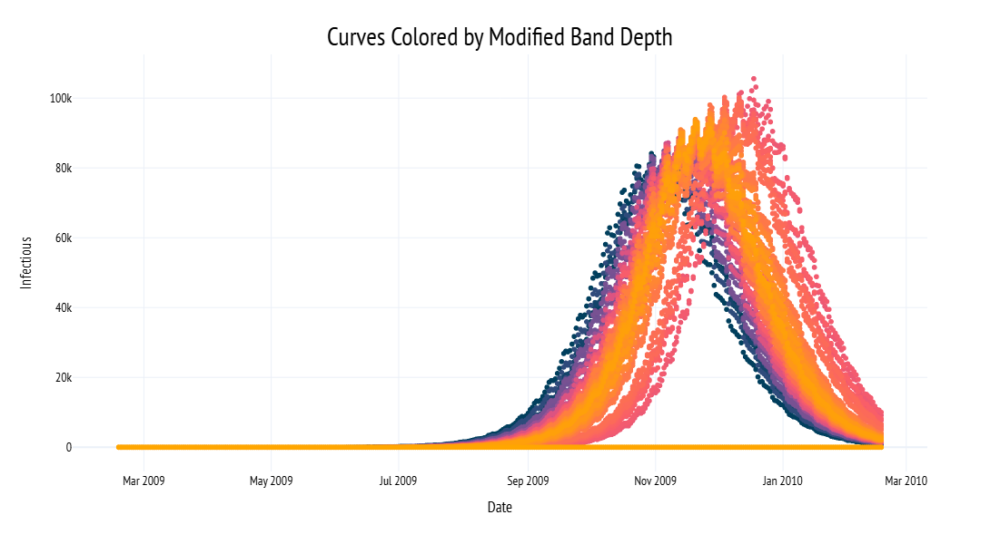

In [19]:
fig = px.scatter(df_master.sort_values('Cume Dist Method'), x='date', y='Infectious_40_44', color='Cume Dist Method', 
           # color_continuous_scale='portland', 
          template=netsi)
fig.update_layout(coloraxis_showscale=False, font_family='PT Sans Narrow',
          title='Curves Colored by Modified Band Depth',
          xaxis_title='Date', yaxis_title='Infectious', 
                 width=1000, height=600)

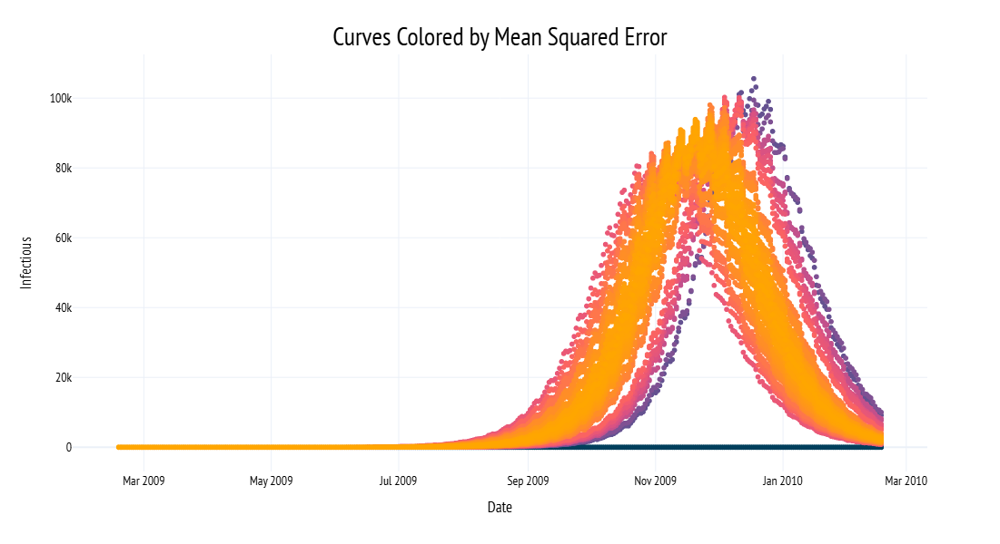

In [18]:
fig = px.scatter(df_master.sort_values('mse'), x='date', y='Infectious_40_44', color='mse', 
           # color_continuous_scale='portland', 
          template=netsi)
fig.update_layout(coloraxis_showscale=False, font_family='PT Sans Narrow',
          title='Curves Colored by Mean Squared Error',
          xaxis_title='Date', yaxis_title='Infectious', 
                 width=1000, height=600)

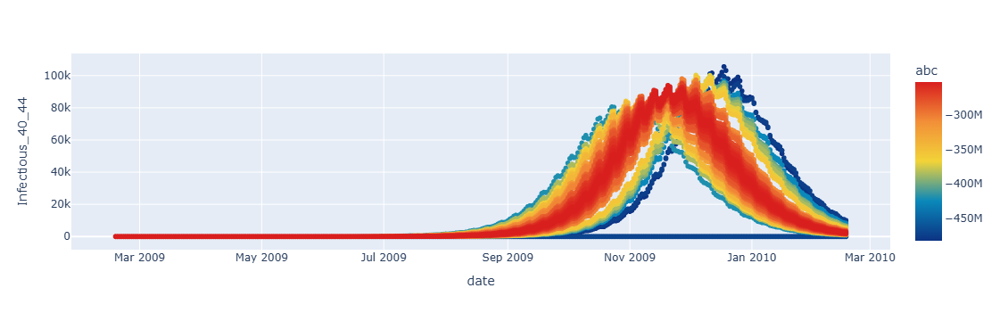

In [17]:
px.scatter(df_master.sort_values('abc'), x='date', y='Infectious_40_44', color='abc', color_continuous_scale='portland')